In [1]:
from _utils import *

# Load dataset from file
folder_path = '/mnt/home/tudomlumleart/ceph/10_ToniaDataset/ToniaDataset_withPolys.mat'


2024-09-30 12:56:10.941896: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-09-30 12:56:10.985644: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX512F AVX512_VNNI, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
dataset = scipy.io.loadmat(folder_path)

/mnt/sw/nix/store/gpkc8q6zjnp3n3h3w9hbmbj6gjbxs85w-python-3.10.10-view/lib/python3.10/site-packages/scipy/io/matlab/_mio.py:227: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [3]:
sorted(dataset.keys())

['HoxTAD',
 'Hox_bad_hybs',
 'None',
 'SoxTAD',
 'Sox_bad_hybs',
 '__function_workspace__',
 '__globals__',
 '__header__',
 '__version__',
 'allHox',
 'allPolysHox',
 'allPolysSox',
 'allSox',
 'badHox',
 'badSox',
 'ctcfNtPolysHox',
 'ctcfNtPolysSox',
 'ctcfPolysHox',
 'ctcfPolysSox',
 'nB',
 'ntPolysHox',
 'ntPolysSox',
 'radNtPolysHox',
 'radNtPolysSox',
 'radPolysHox',
 'radPolysSox',
 'spotCodes_samples']

In [4]:
# Hox locus dataset
nHox = 72
ctcfNtPolysHox = dataset['ctcfNtPolysHox']
ctcfPolysHox = dataset['ctcfPolysHox']
ntPolysHox = dataset['ntPolysHox']
radNtPolysHox = dataset['radNtPolysHox']
radPolysHox = dataset['radPolysHox']

# Sox locus dataset
nSox = 93
ctcfNtPolysSox = dataset['ctcfNtPolysSox']
ctcfPolysSox = dataset['ctcfPolysSox']
ntPolysSox = dataset['ntPolysSox']
radNtPolysSox = dataset['radNtPolysSox']
radPolysSox = dataset['radPolysSox']

In [5]:
# Interpolate polymers to fill in the NaN values 
ctcfNtPolysHox = interpolate_polymers(ctcfNtPolysHox)
ctcfPolysHox = interpolate_polymers(ctcfPolysHox)
ntPolysHox = interpolate_polymers(ntPolysHox)
radNtPolysHox = interpolate_polymers(radNtPolysHox)
radPolysHox = interpolate_polymers(radPolysHox)

ctcfNtPolysSox = interpolate_polymers(ctcfNtPolysSox)
ctcfPolysSox = interpolate_polymers(ctcfPolysSox)
ntPolysSox = interpolate_polymers(ntPolysSox)
radNtPolysSox = interpolate_polymers(radNtPolysSox)
radPolysSox = interpolate_polymers(radPolysSox)

In [6]:
def calculate_distance_map(polys):
    # Extract the dimensions of the input array
    num_probes, num_coords, num_cells = polys.shape
    
    # Initialize an array of the same shape to hold the interpolated values
    new_maps = np.zeros((num_cells, num_probes, num_probes))
    
    # Iterate over each cell
    for c in range(num_cells):
        # Extract the data for the current cell
        curr_cells = polys[:, :, c]
        
        # Skip cells with all missing values
        if np.all(np.isnan(curr_cells)):
            continue  # This leaves a matrix of zeros in the output array
        
        # Calculate the pairwise Euclidean distance between each pair of probes
        dmap = squareform(pdist(curr_cells))
        
        # Assign the distance map to the corresponding position in the output array
        new_maps[c, :, :] = dmap
    
    # Return the array with interpolated values
    return new_maps

In [7]:
# Generate distance maps from interpolated polymers
ctcfNtMapsHox = calculate_distance_map(ctcfNtPolysHox)
ctcfMapsHox = calculate_distance_map(ctcfPolysHox)
ntMapsHox = calculate_distance_map(ntPolysHox)
radNtMapsHox = calculate_distance_map(radNtPolysHox)
radMapsHox = calculate_distance_map(radPolysHox)

ctcfNtMapsSox = calculate_distance_map(ctcfNtPolysSox)
ctcfMapsSox = calculate_distance_map(ctcfPolysSox)
ntMapsSox = calculate_distance_map(ntPolysSox)
radNtMapsSox = calculate_distance_map(radNtPolysSox)
radMapsSox = calculate_distance_map(radPolysSox)

In [8]:
# Plot the median maps of these distance maps 
# To check if the distance maps are reasonable
ctcfNtMapsHox_median = np.nanmedian(ctcfNtMapsHox, axis=0)
ctcfMapsHox_median = np.nanmedian(ctcfMapsHox, axis=0)
ntMapsHox_median = np.nanmedian(ntMapsHox, axis=0)
radNtMapsHox_median = np.nanmedian(radNtMapsHox, axis=0)
radMapsHox_median = np.nanmedian(radMapsHox, axis=0)

ctcfNtMapsSox_median = np.nanmedian(ctcfNtMapsSox, axis=0)
ctcfMapsSox_median = np.nanmedian(ctcfMapsSox, axis=0)
ntMapsSox_median = np.nanmedian(ntMapsSox, axis=0)
radNtMapsSox_median = np.nanmedian(radNtMapsSox, axis=0)
radMapsSox_median = np.nanmedian(radMapsSox, axis=0)

Text(0.5, 1.0, 'Deg CTCF Sox')

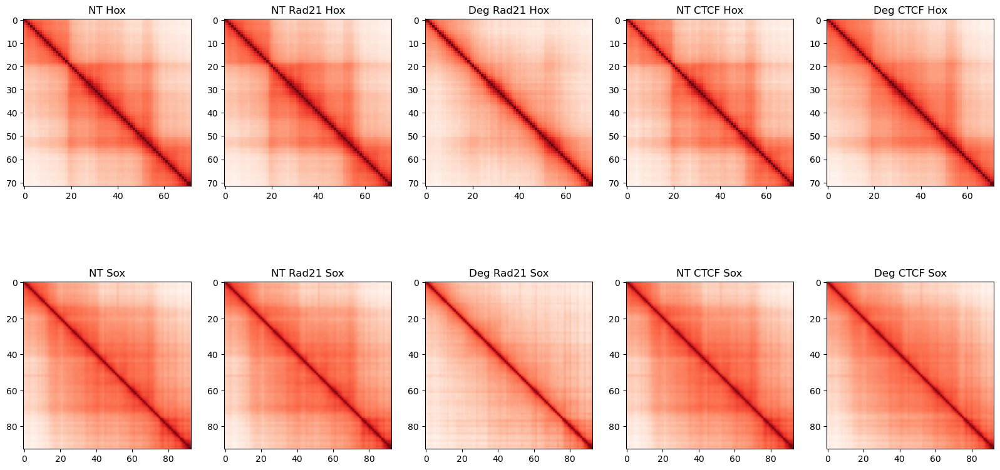

In [9]:
# Plot the median maps of these distance maps
# 2 Rows of plots for Hox and Sox loci
# 5 Columns of plots for different distance maps
fig, axs = plt.subplots(2, 5, figsize=(20, 10))
axs[0, 0].imshow(ntMapsHox_median, cmap='Reds_r')
axs[0, 0].set_title('NT Hox')
axs[0, 1].imshow(radNtMapsHox_median, cmap='Reds_r')
axs[0, 1].set_title('NT Rad21 Hox')
axs[0, 2].imshow(radMapsHox_median, cmap='Reds_r')
axs[0, 2].set_title('Deg Rad21 Hox')
axs[0, 3].imshow(ctcfNtMapsHox_median, cmap='Reds_r')
axs[0, 3].set_title('NT CTCF Hox')
axs[0, 4].imshow(ctcfMapsHox_median, cmap='Reds_r')
axs[0, 4].set_title('Deg CTCF Hox')

axs[1, 0].imshow(ntMapsSox_median, cmap='Reds_r')
axs[1, 0].set_title('NT Sox')
axs[1, 1].imshow(radNtMapsSox_median, cmap='Reds_r')
axs[1, 1].set_title('NT Rad21 Sox')
axs[1, 2].imshow(radMapsSox_median, cmap='Reds_r')
axs[1, 2].set_title('Deg Rad21 Sox')
axs[1, 3].imshow(ctcfNtMapsSox_median, cmap='Reds_r')
axs[1, 3].set_title('NT CTCF Sox')
axs[1, 4].imshow(ctcfMapsSox_median, cmap='Reds_r')
axs[1, 4].set_title('Deg CTCF Sox')


In [10]:
# Generate flatten maps from distance maps
ctcfNtFlattenHox = np.array([x.flatten() for x in ctcfNtMapsHox])
ctcfFlattenHox = np.array([x.flatten() for x in ctcfMapsHox])
ntFlattenHox = np.array([x.flatten() for x in ntMapsHox])
radNtFlattenHox = np.array([x.flatten() for x in radNtMapsHox])
radFlattenHox = np.array([x.flatten() for x in radMapsHox])

ctcfNtFlattenSox = np.array([x.flatten() for x in ctcfNtMapsSox])
ctcfFlattenSox = np.array([x.flatten() for x in ctcfMapsSox])
ntFlattenSox = np.array([x.flatten() for x in ntMapsSox])
radNtFlattenSox = np.array([x.flatten() for x in radNtMapsSox])
radFlattenSox = np.array([x.flatten() for x in radMapsSox])

In [11]:
ctcfNtMapsHox.shape

(5505, 72, 72)

In [12]:
ctcfNtFlattenHox.shape

(5505, 5184)

In [13]:
allFlattenHox = np.concatenate((ctcfNtFlattenHox, ctcfFlattenHox, ntFlattenHox, radNtFlattenHox, radFlattenHox), axis=0)

In [14]:
pca_hox = PCA(n_components=2)
pca_hox.fit(allFlattenHox)
# Fit the PCA model to all Hox datasets
ctcfNtHox = pca_hox.transform(ctcfNtFlattenHox)
ctcfHox = pca_hox.transform(ctcfFlattenHox)
ntHox = pca_hox.transform(ntFlattenHox)
radNtHox = pca_hox.transform(radNtFlattenHox)
radHox = pca_hox.transform(radFlattenHox)

In [15]:
# Convert the principal components to a DataFrame
ctcfNtHox_df = pd.DataFrame(ctcfNtHox, columns=['PC1', 'PC2'])
ctcfNtHox_df['label'] = 'ctcfNtHox'
ctcfHox_df = pd.DataFrame(ctcfHox, columns=['PC1', 'PC2'])
ctcfHox_df['label'] = 'ctcfDegHox'
ntHox_df = pd.DataFrame(ntHox, columns=['PC1', 'PC2'])
ntHox_df['label'] = 'ntHox'
radNtHox_df = pd.DataFrame(radNtHox, columns=['PC1', 'PC2'])
radNtHox_df['label'] = 'radNtHox'
radHox_df = pd.DataFrame(radHox, columns=['PC1', 'PC2'])
radHox_df['label'] = 'radDegHox'

In [16]:
all_df = pd.concat([ntHox_df, radNtHox_df, radHox_df, ctcfNtHox_df, ctcfHox_df], axis=0)

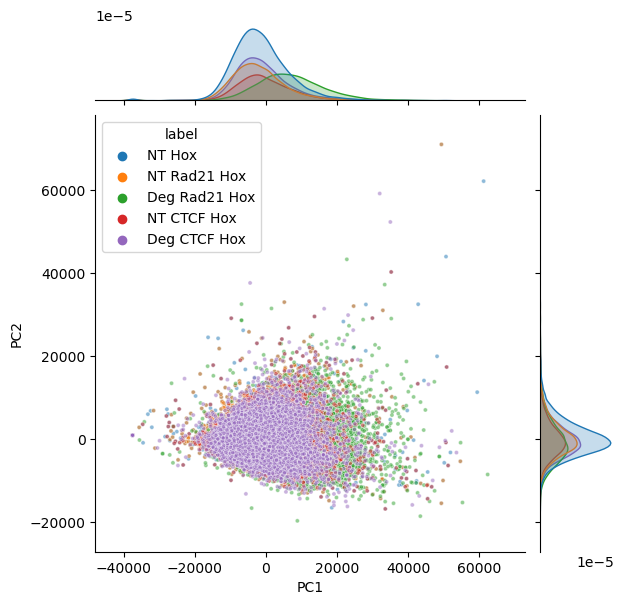

In [17]:
g = sns.jointplot(data=all_df, x='PC1', y='PC2', hue='label', marker='.', alpha=0.5)
# Add custom legend using Matplotlib
# First, get the legend elements manually
handles, labels = g.ax_joint.get_legend_handles_labels()

# Customize the labels if needed
custom_labels = ['NT Hox', 'NT Rad21 Hox', 'Deg Rad21 Hox', 'NT CTCF Hox', 'Deg CTCF Hox'] # Example custom labels

# Remove any existing legend
g.ax_joint.legend_.remove()

# Add custom legend
plt.legend(handles=handles, labels=custom_labels, loc="best", title="label")

In [18]:
# PCA for Sox locus
allFlattenSox = np.concatenate((ctcfNtFlattenSox, ctcfFlattenSox, ntFlattenSox, radNtFlattenSox, radFlattenSox), axis=0)
pca_sox = PCA(n_components=2)
pca_sox.fit(allFlattenSox)
# Fit the PCA model to all Sox datasets
ctcfNtSox = pca_sox.transform(ctcfNtFlattenSox)
ctcfSox = pca_sox.transform(ctcfFlattenSox)
ntSox = pca_sox.transform(ntFlattenSox)
radNtSox = pca_sox.transform(radNtFlattenSox)
radSox = pca_sox.transform(radFlattenSox)


In [19]:
# Convert the principal components to a DataFrame
ctcfNtSox_df = pd.DataFrame(ctcfNtSox, columns=['PC1', 'PC2'])
ctcfNtSox_df['label'] = 'ctcfNtSox'
ctcfSox_df = pd.DataFrame(ctcfSox, columns=['PC1', 'PC2'])
ctcfSox_df['label'] = 'ctcfDegSox'
ntSox_df = pd.DataFrame(ntSox, columns=['PC1', 'PC2'])
ntSox_df['label'] = 'ntSox'
radNtSox_df = pd.DataFrame(radNtSox, columns=['PC1', 'PC2'])
radNtSox_df['label'] = 'radNtSox'
radSox_df = pd.DataFrame(radSox, columns=['PC1', 'PC2'])
radSox_df['label'] = 'radDegSox'

In [20]:
all_df_sox = pd.concat([ntSox_df, radNtSox_df, radSox_df, ctcfNtSox_df, ctcfSox_df], axis=0)


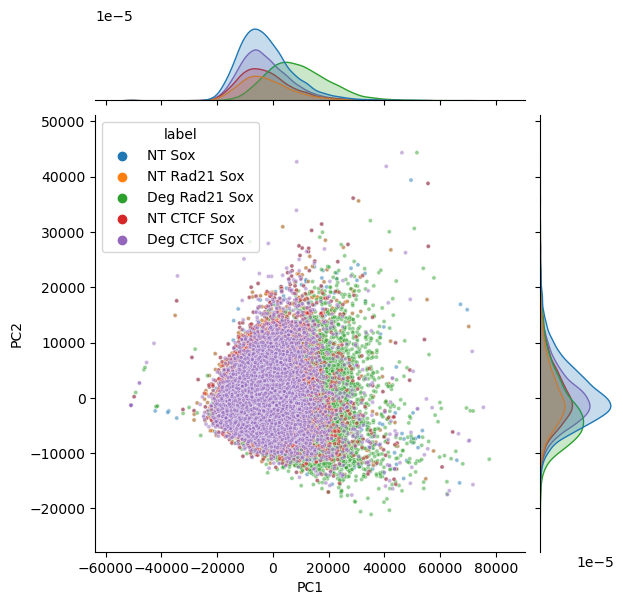

In [21]:
g = sns.jointplot(data=all_df_sox, x='PC1', y='PC2', hue='label', marker='.', alpha=0.5)
# Add custom legend using Matplotlib
# First, get the legend elements manually
handles, labels = g.ax_joint.get_legend_handles_labels()

# Customize the labels if needed
custom_labels = ['NT Sox', 'NT Rad21 Sox', 'Deg Rad21 Sox', 'NT CTCF Sox', 'Deg CTCF Sox'] # Example custom labels

# Remove any existing legend
g.ax_joint.legend_.remove()

# Add custom legend
plt.legend(handles=handles, labels=custom_labels, loc="best", title="label")

In [22]:
# Find the lower and upper bounds of the PC1 and PC2 for Hox locus
min_pc1_hox = min(all_df['PC1'])
max_pc1_hox = max(all_df['PC1'])
min_pc2_hox = min(all_df['PC2'])
max_pc2_hox = max(all_df['PC2'])

# Find the lower and upper bounds of the PC1 and PC2 for Sox locus
min_pc1_sox = min(all_df_sox['PC1'])
max_pc1_sox = max(all_df_sox['PC1'])
min_pc2_sox = min(all_df_sox['PC2'])
max_pc2_sox = max(all_df_sox['PC2'])

In [23]:
import numpy as np
import pandas as pd

def generate_microstates(min_pc1, max_pc1, min_pc2, max_pc2, num_microstates, pca_model):
    """
    Generates a grid of points (microstates) based on provided PCA components ranges, 
    sorts them, and applies inverse transformation using the given PCA model.
    
    Parameters:
    ----------
    min_pc1 : float
        Minimum value for the first principal component (PC1).
    max_pc1 : float
        Maximum value for the first principal component (PC1).
    min_pc2 : float
        Minimum value for the second principal component (PC2).
    max_pc2 : float
        Maximum value for the second principal component (PC2).
    num_microstates : int
        Number of microstates (grid points) to generate for each component.
    pca_model : sklearn.decomposition.PCA
        Pre-trained PCA model that will be used to inverse transform the generated grid points.
    
    Returns:
    -------
    np.ndarray
        A NumPy array containing the inverse-transformed microstates.
    
    Example:
    -------
    microstates = generate_microstates(-5, 5, -5, 5, 75, pca_model)
    """
    
    # Create a grid of points
    pc1 = np.linspace(min_pc1, max_pc1, num_microstates)
    pc2 = np.linspace(min_pc2, max_pc2, num_microstates)
    pc1, pc2 = np.meshgrid(pc1, pc2)
    pc1 = pc1.flatten()
    pc2 = pc2.flatten()

    # Create a DataFrame from the grid points
    grid = pd.DataFrame({'PC1': pc1, 'PC2': pc2})

    # Sort PC2 in descending order while keeping PC1 in ascending order
    grid_sorted = grid.sort_values(by=['PC1', 'PC2'], ascending=[True, False], ignore_index=True)

    # Apply inverse transformation using the provided PCA model
    microstates = pca_model.inverse_transform(grid_sorted)

    return microstates

In [24]:
# Create a grid of points for Hox locus
# num_microstates = 75 # Number of microstates to generate

# use 5 microstates for debugging
num_microstates = 5

pc1_hox = np.linspace(min_pc1_hox, max_pc1_hox, num_microstates)
pc2_hox = np.linspace(min_pc2_hox, max_pc2_hox, num_microstates)
pc1_hox, pc2_hox = np.meshgrid(pc1_hox, pc2_hox)
pc1_hox = pc1_hox.flatten()
pc2_hox = pc2_hox.flatten()

# Put the grid points into a DataFrame
grid_hox = pd.DataFrame({'PC1': pc1_hox, 'PC2': pc2_hox})
# Sort PC2 in descending order while keeping PC1 in ascending order
grid_hox = grid_hox.sort_values(by=['PC1', 'PC2'], ascending=[True, False], ignore_index=True)

# Infer microstates from PCA for Hox locus
microstates_hox = pca_hox.inverse_transform(grid_hox)

In [25]:
# Use the function I just wrote to generate microstates for the Sox locus
microstates_sox = generate_microstates(min_pc1_sox, max_pc1_sox, min_pc2_sox, max_pc2_sox, 75, pca_sox)

In [26]:
def calculate_conformational_variance_new(dmap_list, microstates_dmap):
    # This is incorrect because it finds mean across all samples 
    """
    Calculate the conformational variation of a set of distance maps relative to a reference map.

    Parameters:
    dmap_list (list): A list of 2D numpy arrays representing the distance maps.
    dmap_ref (np.ndarray): A 2D numpy array representing the reference distance map.
    num_probes (int): The number of probes in the distance maps.

    Returns:
    np.ndarray: A 2D numpy array containing the variance of the squared Euclidean distances 
               between each distance map and the reference map.
    """
    # Convert dmap_list to a NumPy array
    dmap_list = np.array(dmap_list)
    
    num_microstates = microstates_dmap.shape[0]
    num_probes = np.round(microstates_dmap.shape[1] ** 0.5).astype(int)
    
    dmap_list = dmap_list[:, np.newaxis, :]
    microstates_dmap = microstates_dmap[np.newaxis, :, :]
    
    # Calculate the squared Euclidean distance between each distance map and the reference map
    diff_list = np.sqrt((dmap_list - microstates_dmap) ** 2)
    
    # Calculate the variance along the number of observation/cell dimension
    var = np.var(diff_list, axis=0)
    
    return np.reshape(var, (num_microstates, num_probes, num_probes))

In [31]:
def calculate_conformational_variance_jax(dmap_list, dmap_ref):
    """
    Calculate the conformational variation of a set of distance maps relative to a reference map.

    Parameters:
    dmap_list (list): A list of 2D numpy arrays representing the distance maps.
    dmap_ref (np.ndarray): A 2D numpy array representing the reference distance map.
    num_probes (int): The number of probes in the distance maps.

    Returns:
    np.ndarray: A 2D numpy array containing the variance of the squared Euclidean distances 
               between each distance map and the reference map.
    """
    # Convert dmap_list to a NumPy array
    dmap_list = jnp.array(dmap_list)
    
    # Calculate the squared Euclidean distance between each distance map and the reference map
    diff_list = jnp.sqrt((dmap_list - dmap_ref) ** 2) 
    
    # Calculate the variance along the number of observation/cell dimension
    var = jnp.var(diff_list, axis=0)
    
    return var


In [29]:
# Rewrite this in a jax-compatible fashion
from functools import partial
@partial(jax.jit, static_argnums=(2,)) 
def batch_calculate_variances(dmap_list, dmap_ref, num_probes):
    """
    Vectorized version that applies calculate_conformational_variance_jax across a batch of distance maps.
    """
    return jax.vmap(lambda dmap: calculate_conformational_variance_jax(dmap_list, jnp.reshape(dmap, [num_probes, num_probes])))(dmap_ref)


In [27]:
# Calculate variances across all microstates using JAX
ctcfNtHox_std = calculate_conformational_variance_new(ctcfNtMapsHox, microstates_hox)**0.5
ctcfHox_std = calculate_conformational_variance_new(ctcfMapsHox, microstates_hox)**0.5
ntHox_std = calculate_conformational_variance_new(ntMapsHox, microstates_hox)**0.5
radNtHox_std = calculate_conformational_variance_new(radNtMapsHox, microstates_hox)**0.5
radHox_std = calculate_conformational_variance_new(radMapsHox, microstates_hox)**0.5

ValueError: operands could not be broadcast together with shapes (5505,1,72,72) (1,25,5184) 

In [32]:
microstates_hox_jax = jnp.array(microstates_hox)

# Calculate variances across all microstates using JAX
ctcfNtHox_var = batch_calculate_variances(jnp.array(ctcfNtMapsHox), microstates_hox_jax, nHox)
ctcfHox_var = batch_calculate_variances(jnp.array(ctcfMapsHox), microstates_hox_jax, nHox)
ntHox_var = batch_calculate_variances(jnp.array(ntMapsHox), microstates_hox_jax, nHox)
radNtHox_var = batch_calculate_variances(jnp.array(radNtMapsHox), microstates_hox_jax, nHox)
radHox_var = batch_calculate_variances(jnp.array(radMapsHox), microstates_hox_jax, nHox)

In [33]:
# Do the same for the Sox locus
microstates_sox_jax = jnp.array(microstates_sox)

ctcfNtSox_var = batch_calculate_variances(jnp.array(ctcfNtMapsSox), microstates_sox_jax, nSox)
ctcfSox_var = batch_calculate_variances(jnp.array(ctcfMapsSox), microstates_sox_jax, nSox)
ntSox_var = batch_calculate_variances(jnp.array(ntMapsSox), microstates_sox_jax, nSox)
radNtSox_var = batch_calculate_variances(jnp.array(radNtMapsSox), microstates_sox_jax, nSox)
radSox_var = batch_calculate_variances(jnp.array(radMapsSox), microstates_sox_jax, nSox)

In [35]:
lpm_hox = [(logprior(x, nHox)).tolist() for x in microstates_hox]
lpm_sox = [(logprior(x, nSox)).tolist() for x in microstates_sox]

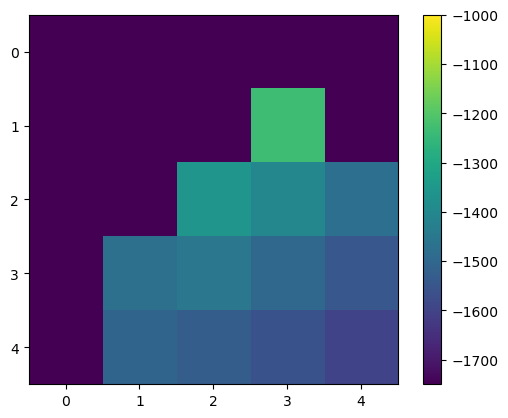

In [36]:
plt.imshow(np.array(lpm_hox).reshape(num_microstates, num_microstates), vmin=-1750, vmax=-1000)
plt.colorbar()

In [37]:
from jax import lax

In [38]:
# Define the main loglikelihood function using JAX
def loglikelihood_jax(dmap_flat, ref_dmap_flat, measurement_error, num_probes):
    return jnp.sum(_loglikelihood_jax(dmap_flat, ref_dmap_flat, measurement_error, num_probes))

# Define the helper function, with JAX-compatible logic
def _loglikelihood_jax(dmap_flat, ref_dmap_flat, measurement_error, num_probes):
    # Use lax.cond for control flow based on the condition
    min_value = jnp.iinfo(jnp.int32).min
    
    def handle_invalid_reference(ref_dmap_flat):
        # Return extremely low probability when ref_dmap_flat contains invalid values
        return jnp.array([jnp.float32(min_value), jnp.float32(min_value)])
    
    def handle_valid_reference(ref_dmap_flat):
        # Calculate the difference between distance map and reference 
        subtraction_map_sq = jnp.square(dmap_flat - ref_dmap_flat).reshape(num_probes, num_probes)

        # Only consider the upper triangular part of the distance map
        # because the diagonal values do not have variance
        triu_indices = jnp.triu_indices(num_probes, k=1)
        measurement_error_scaled = 2 * measurement_error[triu_indices]  # both triangles 
        subtraction_map_sq_scaled = 2 * subtraction_map_sq[triu_indices]  # both triangles
        
        # Calculate the normalization factor
        normalization_factor = -jnp.sum(jnp.log(jnp.sqrt(2 * jnp.pi * measurement_error_scaled**2)))
        
        # Calculate the Gaussian term 
        gaussian_term = -jnp.sum(subtraction_map_sq_scaled / (2 * jnp.square(measurement_error_scaled)))
        
        return jnp.array([normalization_factor, gaussian_term])

    # Apply the appropriate logic depending on whether ref_dmap_flat contains negative values
    return lax.cond(
        jnp.any(ref_dmap_flat <= -1),
        handle_invalid_reference,
        handle_valid_reference,
        ref_dmap_flat
    )

In [39]:
def compute_loglikelihood_for_y(y, templates_flatten, measurement_error_esc, num_probes):
    return jax.vmap(lambda x, z: loglikelihood_jax(y, x, z, num_probes))(templates_flatten, measurement_error_esc)


In [42]:
ctcfHox_var = batch_calculate_variances(jnp.array(ctcfMapsHox), microstates_hox_jax, nHox)
ntHox_var = batch_calculate_variances(jnp.array(ntMapsHox), microstates_hox_jax, nHox)
radNtHox_var = batch_calculate_variances(jnp.array(radNtMapsHox), microstates_hox_jax, nHox)
radHox_var = batch_calculate_variances(jnp.array(radMapsHox), microstates_hox_jax, nHox)

In [41]:
ctcfNtHox_ll = [compute_loglikelihood_for_y(y, microstates_hox_jax, ctcfNtHox_var, nHox) for y in tqdm(ctcfNtFlattenHox)] 

  0%|          | 0/5505 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [60]:
ctcfNtFlattenHox.shape

(5505, 5184)

In [62]:
microstates_hox_jax.shape

(25, 5184)

In [67]:
microstates_hox[:, np.newaxis, :].shape

(25, 1, 5184)

In [64]:
ctcfNtFlattenHox[np.newaxis, :, :].shape

(1, 5505, 5184)

In [68]:
microstates_hox_expanded = microstates_hox[:, np.newaxis, :]
ctcfNtFlattenHox_expanded = ctcfNtFlattenHox[np.newaxis, :, :]

In [70]:
diff_expanded = ctcfNtFlattenHox_expanded - microstates_hox_expanded

In [75]:
diff_expanded.shape

(25, 5505, 5184)

In [42]:
ctcfNtHox_ll_debug = [compute_loglikelihood_for_y(y, microstates_hox_jax, ctcfNtHox_var, nHox) for y in tqdm(ctcfNtFlattenHox[:10])] 

  0%|          | 0/10 [00:00<?, ?it/s]

In [51]:
np.array(ctcfNtHox_ll_debug).shape

(10, 25)

In [45]:
ll_esc = [[(loglikelihood(y, x, z, nHox)).tolist() for x, z in zip(microstates_hox, ctcfNtHox_var)] for y in tqdm(ctcfNtFlattenHox[:10])]

  0%|          | 0/10 [00:00<?, ?it/s]

In [49]:
np.array(ll_esc).shape

(10, 25)

In [56]:
ctcfNtHox_ll_debug[0] - np.array(ll_esc[0])  # so these are the same

Array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.00195312, -0.00390625,  0.        ,
        0.        , -0.00195312,  0.00195312,  0.        ,  0.00390625],      dtype=float32)

In [54]:
ctcfNtHox_ll = np.array(ctcfNtHox_ll)

NameError: name 'ctcfNtHox_ll' is not defined

In [54]:
ctcfNtHox_ll.sum(axis=1)[1]

-11136948000000.0

In [46]:
num_microstates**2

5625

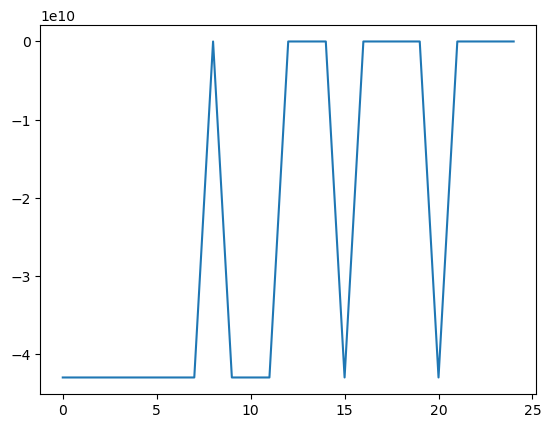

In [58]:
plt.plot(sum(ctcfNtHox_ll_debug))

In [59]:
# Calculate likelihood for Hox samples
ctcfNtHox_ll = [compute_loglikelihood_for_y(y, microstates_hox_jax, ctcfNtHox_var, nHox) for y in tqdm(ctcfNtFlattenHox)] 
ctcfHox_ll = [compute_loglikelihood_for_y(y, microstates_hox_jax, ctcfHox_var, nHox) for y in tqdm(ctcfFlattenHox)]


  0%|          | 0/5505 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [44]:
ntHox_ll = [compute_loglikelihood_for_y(y, microstates_hox_jax, ntHox_var, nHox) for y in tqdm(ntFlattenHox)]
radNtHox_ll = [compute_loglikelihood_for_y(y, microstates_hox_jax, radNtHox_var, nHox) for y in tqdm(radNtFlattenHox)]
radHox_ll = [compute_loglikelihood_for_y(y, microstates_hox_jax, radHox_var, nHox) for y in tqdm(radFlattenHox)]

  0%|          | 0/15319 [00:00<?, ?it/s]

  0%|          | 0/7855 [00:00<?, ?it/s]

  0%|          | 0/7462 [00:00<?, ?it/s]

In [45]:
# Convert all jnp arrays to list 
ctcfNtHox_ll = [x.tolist() for x in ctcfNtHox_ll]
ctcfHox_ll = [x.tolist() for x in ctcfHox_ll]
ntHox_ll = [x.tolist() for x in ntHox_ll]
radNtHox_ll = [x.tolist() for x in radNtHox_ll]
radHox_ll = [x.tolist() for x in radHox_ll]

In [46]:
# Calculate likelihood for Sox samples
ctcfNtSox_ll = [compute_loglikelihood_for_y(y, microstates_sox_jax, ctcfNtSox_var, nSox) for y in tqdm(ctcfNtFlattenSox)]
ctcfSox_ll = [compute_loglikelihood_for_y(y, microstates_sox_jax, ctcfSox_var, nSox) for y in tqdm(ctcfFlattenSox)]
ntSox_ll = [compute_loglikelihood_for_y(y, microstates_sox_jax, ntSox_var, nSox) for y in tqdm(ntFlattenSox)]
radNtSox_ll = [compute_loglikelihood_for_y(y, microstates_sox_jax, radNtSox_var, nSox) for y in tqdm(radNtFlattenSox)]
radSox_ll = [compute_loglikelihood_for_y(y, microstates_sox_jax, radSox_var, nSox) for y in tqdm(radFlattenSox)]


  0%|          | 0/5451 [00:00<?, ?it/s]

  0%|          | 0/7902 [00:00<?, ?it/s]

  0%|          | 0/11900 [00:00<?, ?it/s]

  0%|          | 0/4094 [00:00<?, ?it/s]

  0%|          | 0/8090 [00:00<?, ?it/s]

In [47]:
# Convert all jnp arrays to list
ctcfNtSox_ll = [x.tolist() for x in ctcfNtSox_ll]
ctcfSox_ll = [x.tolist() for x in ctcfSox_ll]
ntSox_ll = [x.tolist() for x in ntSox_ll]
radNtSox_ll = [x.tolist() for x in radNtSox_ll]
radSox_ll = [x.tolist() for x in radSox_ll]

In [68]:
# Calculate the number of cells in each dataset
N_ctcfNtHox = ctcfNtMapsHox.shape[0]
N_ctcfHox = ctcfMapsHox.shape[0]
N_ntHox = ntMapsHox.shape[0]
N_radNtHox = radNtMapsHox.shape[0]
N_radHox = radMapsHox.shape[0]

N_ctcfNtSox = ctcfNtMapsSox.shape[0]
N_ctcfSox = ctcfMapsSox.shape[0]
N_ntSox = ntMapsSox.shape[0]
N_radNtSox = radNtMapsSox.shape[0]
N_radSox = radMapsSox.shape[0]

In [64]:
ctcfNtMapsHox.shape

(8737, 72, 72)

In [67]:
np.array(ctcfHox_ll).shape

(8737, 5625)

In [49]:
M = 75**2  # Number of microstates

In [50]:
# Load stan model 
my_model = CmdStanModel(
    stan_file='/mnt/home/tudomlumleart/ceph/01_ChromatinEnsembleRefinement/chromatin-ensemble-refinement/scripts/stan/20240715_WeightOptimization.stan',
    cpp_options = {
        "STAN_THREADS": True,
    }
    )

In [51]:
n_cores = multiprocessing.cpu_count()
print(f"Number of CPU cores: {n_cores}")
parallel_chains = 4
threads_per_chain = int(n_cores / parallel_chains)
print(f"Number of threads per chain: {threads_per_chain}")

Number of CPU cores: 64
Number of threads per chain: 16


In [52]:
save_dir = '/mnt/home/tudomlumleart/ceph/01_ChromatinEnsembleRefinement/chromatin-ensemble-refinement/MCMC_results/20240923_RunWeightMCMC_Tonia_PCA'

In [53]:
conditions = [
    'ctcfNtHox', 'ctcfHox', 'ntHox', 'radNtHox', 'radHox',
    'ctcfNtSox', 'ctcfSox', 'ntSox', 'radNtSox', 'radSox'
]

In [60]:
lpm_hox

AttributeError: 'list' object has no attribute 'shape'

In [70]:
for condition in tqdm(conditions):
    output_dir = os.path.join(save_dir, condition)
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    json_filename = os.path.join(output_dir, 'data.json')
    stan_putput_file = os.path.join(output_dir, 'stan_output')
    
    # Generate a datadict for the current condition
    if condition == 'ctcfNtHox':
        data_dict = {
            'N': N_ctcfNtHox,
            'M': M,
            'll_map': ctcfNtHox_ll,
            'lpm_vec': lpm_hox
        }
    elif condition == 'ctcfHox':
        data_dict = {
            'N': N_ctcfHox,
            'M': M,
            'll_map': ctcfHox_ll,
            'lpm_vec': lpm_hox
        }
    elif condition == 'ntHox':
        data_dict = {
            'N': N_ntHox,
            'M': M,
            'll_map': ntHox_ll,
            'lpm_vec': lpm_hox
        }
    elif condition == 'radNtHox':
        data_dict = {
            'N': N_radNtHox,
            'M': M,
            'll_map': radNtHox_ll,
            'lpm_vec': lpm_hox
        }
    elif condition == 'radHox':
        data_dict = {
            'N': N_radHox,
            'M': M,
            'll_map': radHox_ll,
            'lpm_vec': lpm_hox
        }
    elif condition == 'ctcfNtSox':
        data_dict = {
            'N': N_ctcfNtSox,
            'M': M,
            'll_map': ctcfNtSox_ll,
            'lpm_vec': lpm_sox
        }
    elif condition == 'ctcfSox':
        data_dict = {
            'N': N_ctcfSox,
            'M': M,
            'll_map': ctcfSox_ll,
            'lpm_vec': lpm_sox
        }
    elif condition == 'ntSox':
        data_dict = {
            'N': N_ntSox,
            'M': M,
            'll_map': ntSox_ll,
            'lpm_vec': lpm_sox
        }
    elif condition == 'radNtSox':
        data_dict = {
            'N': N_radNtSox,
            'M': M,
            'll_map': radNtSox_ll,
            'lpm_vec': lpm_sox
        }
    elif condition == 'radSox':
        data_dict = {
            'N': N_radSox,
            'M': M,
            'll_map': radSox_ll,
            'lpm_vec': lpm_sox
        }
    
    json_obj = json.dumps(data_dict, indent=4)
    
    with open(json_filename, 'w') as json_file:
        json_file.write(json_obj)
        json_file.close()
    
    
    

  0%|          | 0/2 [00:00<?, ?it/s]

In [55]:
data_dict

{'N': 8090,
 'M': 5625,
 'll_map': [[-4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -4294967296.0,
   -42949672